## Informe COVID-19 
#### 08/03/2020

Ing. Javier Blanco 

### Importando Librerías Útiles

In [1]:
import matplotlib
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
import datetime, time, requests
from time import sleep

### Extrayendo Datos

Corona Virus DataSet

`https://github.com/CSSEGISandData/COVID-19/tree/master/csse_covid_19_data/csse_covid_19_daily_reports`

In [34]:
Covid2019_data = pd.read_csv("Covid2019_data.csv")
Covid2019_data['Last Update'] = pd.to_datetime(Covid2019_data['Last Update'])
Covid2019_data = Covid2019_data.sort_values('Last Update',ascending=True)
print('Dimension:', Covid2019_data.shape)
print('Fecha Min:', np.min(Covid2019_data['Last Update']),'Fecha Max:',np.max(Covid2019_data['Last Update']))

#Limpiando data de los NaN. 
Covid2019_data['Province/State'] = Covid2019_data['Province/State'].fillna('Sin Datos')
Covid2019_data.tail()


Dimension: (225, 8)
Fecha Min: 2020-02-03 03:53:02 Fecha Max: 2020-03-07 23:53:03


,Province/State,Country/Region,Last Update,Confirmed,Deaths,Recovered,Latitude,Longitude
15,Chongqing,Mainland China,2020-03-07 23:23:02,576,6,526,30.0572,107.8740
59,"Santa Clara County, CA",US,2020-03-07 23:43:03,32,0,1,37.3541,-121.9552
206,"Santa Cruz County, CA",US,2020-03-07 23:43:03,1,0,0,36.9741,-122.0308
91,"San Francisco County, CA",US,2020-03-07 23:53:03,9,0,0,37.7749,-122.4194
79,"Los Angeles, CA",US,2020-03-07 23:53:03,14,0,0,34.0522,-118.2437


## Explorando y Preparando Datos

Un vez obtenidos y dimensionados los datos del CoronaVirus (COVID-2019) procedo a explorar la información arrojada y sacar provecho de esta


In [35]:
#cuantos nan? voy a revisarlo
contar_Nan = len(Covid2019_data) - Covid2019_data.count()
contar_Nan


Province/State    0
Country/Region    0
Last Update       0
Confirmed         0
Deaths            0
Recovered         0
Latitude          0
Longitude         0
dtype: int64

In [36]:
#¿Cuantos Países tengo?
paises = list(set(Covid2019_data['Country/Region']))
print('Paises por Unidad encontrados:', str(len(paises)))
paises

Paises por Unidad encontrados: 102


['Costa Rica',
 'Oman',
 'Vietnam',
 'Nepal',
 'Brazil',
 'Algeria',
 'Singapore',
 'Pakistan',
 'Canada',
 'Georgia',
 'Mexico',
 'UK',
 'Slovenia',
 'Andorra',
 'Macau',
 'Israel',
 'Indonesia',
 'Cameroon',
 'Japan',
 'France',
 'Croatia',
 'United Arab Emirates',
 'Hong Kong',
 'Spain',
 'Slovakia',
 'Togo',
 'North Macedonia',
 'Italy',
 'Saint Barthelemy',
 'Sweden',
 'Lithuania',
 'Switzerland',
 'Germany',
 'Cambodia',
 'Ukraine',
 'Qatar',
 'Norway',
 'Monaco',
 'Azerbaijan',
 'Liechtenstein',
 'Mainland China',
 'Malta',
 'Peru',
 'Egypt',
 'Senegal',
 'Bosnia and Herzegovina',
 'Kuwait',
 'Saudi Arabia',
 'Sri Lanka',
 'US',
 'Chile',
 'Estonia',
 'Hungary',
 'South Africa',
 'Iraq',
 'French Guiana',
 'Lebanon',
 'Greece',
 'Finland',
 'Argentina',
 'Australia',
 'Austria',
 'Faroe Islands',
 'Czech Republic',
 'Philippines',
 'Latvia',
 'Iran',
 'Dominican Republic',
 'Luxembourg',
 'Thailand',
 'Jordan',
 'Gibraltar',
 'Netherlands',
 'Iceland',
 'Palestine',
 'Bhutan',
 

In [37]:
#y Aquí voy por las provincias
zonas = list((set(Covid2019_data['Province/State'])))
print('Zonas Unicas encontradas:', str(len(zonas)))
zonas

Zonas Unicas encontradas: 132


[' Norfolk County, MA',
 'Jackson County, OR ',
 'Travis, CA (From Diamond Princess)',
 'Fujian',
 'Honolulu County, HI',
 'Washoe County, NV',
 'Montgomery County, MD',
 'Tibet',
 'Lackland, TX (From Diamond Princess)',
 'Fulton County, GA',
 'Contra Costa County, CA',
 'Yunnan',
 'Unassigned Location, WA',
 'Middlesex County, MA',
 'Hunan',
 'Sonoma County, CA',
 'Charleston County, SC',
 'Davis County, UT',
 'Edmonton, Alberta',
 'Shandong',
 'San Benito, CA',
 'Grafton County, NH',
 'Macau',
 'Wayne County, PA',
 'Guangxi',
 'Nassau County, NY',
 'Qinghai',
 'San Antonio, TX',
 'Queensland',
 'Hainan',
 'Western Australia',
 'Saratoga County, NY',
 'Orange County, CA',
 'Westchester County, NY',
 'Hong Kong',
 'Zhejiang',
 'New South Wales',
 'Jiangxi',
 'Lee County, FL',
 'San Diego County, CA',
 'Suffolk County, MA',
 'Northern Territory',
 'Fayette County, KY',
 'Tianjin',
 'South Australia',
 'Delaware County, PA',
 ' Montreal, QC',
 'New York County, NY',
 'Bergen County, NJ',

## Uso de API externa (openstreetmap)
Util para obtener latitudes y longitudes para cada país

In [38]:
#defino función
def get_lat_lon(zone,output_as ='center'):
    ##el API es util para crear un URL
    url ='{0}{1}{2}'.format('http://nominatim.openstreetmap.org/search?q=',zone,'&format=json&polygon=0')
    
    #Enviando petición al servidor
    response = requests.get(url).json()[0]
    
    #cambiando formato de respuesta a lista (parsing)
    if output_as == 'boundingbox':
        lst = response[output_as]
        output = [float(i) for i in lst]
    if output_as == 'center':
        lst = [response.get(key) for key in ['lon','lat']]
        output = [float(i) for i in lst]
        
    return output

In [39]:
#comprobando función
get_lat_lon('Madrid')

[-3.7035825, 40.4167047]

In [40]:
#Construyendo centroides
geo_centers_lon = []
geo_centers_lat = []
total_ctry = len(paises)
counter_ = 0

for ctry in paises:
    if counter_  % 10 == 0: print (total_ctry - counter_)
    time.sleep(0.2)
    centroid = [None, None]
    try:
        centroid = get_lat_lon(ctry, output_as='center')
        
    except:
        print ('No se ha encontrado:', ctry)
        
    geo_centers_lon.append(centroid[0])
    geo_centers_lat.append(centroid[1])
    
    
    counter_+=1

102
92
82
72
62
52
42
32
22
12
2


In [10]:
## convierto la data geospacial en dataframes
tot_lats = []
tot_lons = []
for i, r in Covid2019_data.iterrows():
    Pais = r['Country/Region']
    index_list = paises.index(Pais)
    tot_lats.append(geo_centers_lat[index_list])
    tot_lons.append(geo_centers_lon[index_list])
    
##Añadiendo DataFRame
Covid2019_data['Longitude'] = tot_lons
Covid2019_data['Latitude'] = tot_lats
Covid2019_data.head(10)

,Province/State,Country/Region,Last Update,Confirmed,Deaths,Recovered,Latitude,Longitude
18,Yunnan,China,2020-03-11 02:18:14,174,2,170,35.000074,104.999927
15,Fujian,China,2020-03-11 02:18:14,296,1,295,35.000074,104.999927
26,Xinjiang,China,2020-03-11 02:18:14,76,3,73,35.000074,104.999927
32,Tibet,China,2020-03-11 02:18:14,1,0,1,35.000074,104.999927
30,Qinghai,China,2020-03-11 02:18:14,18,0,18,35.000074,104.999927
5,Anhui,China,2020-03-11 02:18:14,990,6,984,35.000074,104.999927
27,Inner Mongolia,China,2020-03-11 03:53:03,75,1,71,35.000074,104.999927
2,Henan,China,2020-03-11 08:13:09,1273,22,1249,35.000074,104.999927
28,Ningxia,China,2020-03-11 09:33:12,75,0,72,35.000074,104.999927
31,Macau,China,2020-03-11 18:52:03,10,0,10,35.000074,104.999927


In [11]:
#Comporbando
Covid2019_data[Covid2019_data['Province/State'] == 'Hong Kong']

,Province/State,Country/Region,Last Update,Confirmed,Deaths,Recovered,Latitude,Longitude
22,Hong Kong,China,2020-03-13 13:33:03,134,4,77,35.000074,104.999927


## Graficando Infección por Países

### Usaremos Basemap



In [49]:
#Uso de Basemap
from mpl_toolkits.basemap import Basemap

def plot_map_mundo(virus_data,date,save_to_file_name = ''):
    #Setting figure dimention
    mi_dpi = 96
    plt.figure(figsize =(2600/mi_dpi, 1800/mi_dpi), dpi = mi_dpi)
    
    #Fondo del mapa
    
    m = Basemap(llcrnrlon=-180, llcrnrlat = -65, urcrnrlon = 180, urcrnrlat=80)
    m.drawmapboundary(fill_color='#f7f7f5',linewidth = 1)
    m.fillcontinents(color='#e8bb51', alpha=0.4)
    m.drawcoastlines(linewidth=0.3, color='grey')
    total_cases = np.sum(virus_data['Confirmed'])
    #total_cases = np.sum(virus_data['Deaths'])
    #total_cases = np.sum(virus_data['Recovered'])
    
    #añdiendo punto de posición
    
    m.scatter(virus_data['Longitude'],virus_data['Latitude'],
             s=virus_data['Confirmed']*8,
             alpha=0.4,
             c=virus_data['labels_enc'],
             cmap='Set1') #aquí me pregunto ¿y si uso escala logaritmica? lo veré después
    plt.title(str(date) + '' + 'Casos Confirmados de COVID-2019:' + str(int(total_cases))+'\n(Circulos no a escala)',fontsize=50)
    
    if save_to_file_name != '':
        plt.savefig(save_to_file_name)
        
    plt.show()
    

    

Creando mapa de colores
un color por punto de acuerdo al continente

In [50]:
Covid2019_data['labels_enc'] = pd.factorize(Covid2019_data['Country/Region'])[0]
Covid2019_data['labels_enc']

148    0
178    1
170    2
157    3
172    4
      ..
15     2
59     0
206    0
91     0
79     0
Name: labels_enc, Length: 225, dtype: int64

C:\Users\javie\Anaconda3\lib\site-packages\ipykernel_launcher.py:11: MatplotlibDeprecationWarning: 
The dedent function was deprecated in Matplotlib 3.1 and will be removed in 3.3. Use inspect.cleandoc instead.
  # This is added back by InteractiveShellApp.init_path()


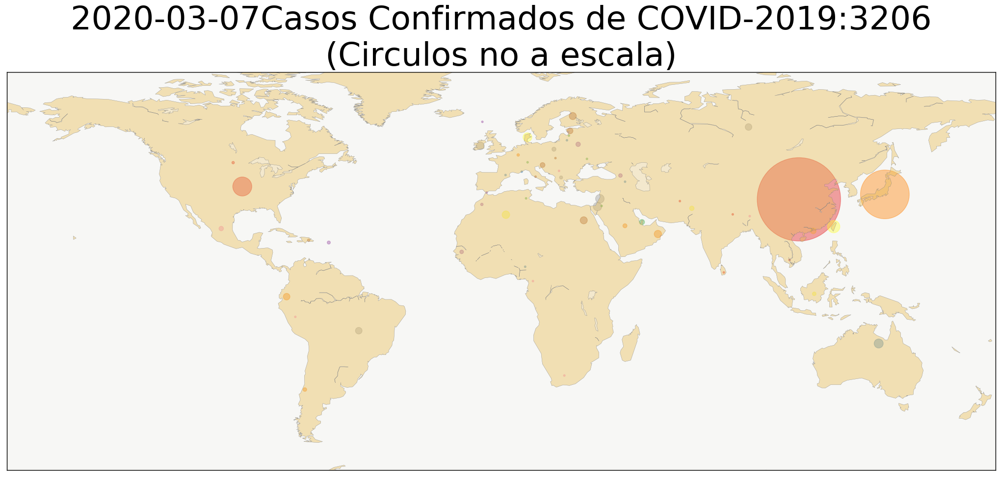

In [51]:
#Comprobando con una fecha
date = '2020-03-07'

virus_today = Covid2019_data[Covid2019_data['Last Update']<= date]

#Simplificando

virus_today = virus_today [['Country/Region','Province/State','labels_enc','Confirmed','Deaths','Recovered','Longitude','Latitude']]

#Obteniendo totales

#Agrupando y sumando por paises y provincias

virus_today = virus_today.groupby(['Country/Region','Province/State','labels_enc']).agg({'Confirmed':'last',
                                                                                        'Deaths':'last',
                                                                                        'Recovered':'last',
                                                                                        'Longitude':'mean',
                                                                                        'Latitude':'mean'}).reset_index()

virus_today=virus_today.groupby(['Country/Region', 'labels_enc']).agg({'Confirmed':'sum', 
                           'Deaths':'sum',
                           'Recovered':'sum',
                           'Longitude':'mean',
                          'Latitude':'mean'}).reset_index()

#mapa de casos confirmados

plot_map_mundo(virus_today, str(date)[0:100])

In [52]:
# construimos un período de tiempo
dates = sorted(list(set(Covid2019_data['Last Update'])))
dates

[Timestamp('2020-02-03 03:53:02'),
 Timestamp('2020-02-08 03:43:03'),
 Timestamp('2020-02-12 06:43:02'),
 Timestamp('2020-02-12 07:43:02'),
 Timestamp('2020-02-12 14:43:03'),
 Timestamp('2020-02-12 18:53:03'),
 Timestamp('2020-02-13 18:53:02'),
 Timestamp('2020-02-21 04:43:02'),
 Timestamp('2020-02-21 05:13:09'),
 Timestamp('2020-02-24 23:33:02'),
 Timestamp('2020-02-27 20:33:02'),
 Timestamp('2020-02-28 16:23:03'),
 Timestamp('2020-02-29 00:33:01'),
 Timestamp('2020-02-29 02:03:10'),
 Timestamp('2020-03-01 19:53:02'),
 Timestamp('2020-03-02 03:23:06'),
 Timestamp('2020-03-02 19:53:03'),
 Timestamp('2020-03-02 20:23:16'),
 Timestamp('2020-03-02 20:53:02'),
 Timestamp('2020-03-03 00:43:02'),
 Timestamp('2020-03-03 15:33:02'),
 Timestamp('2020-03-03 15:53:03'),
 Timestamp('2020-03-03 18:33:02'),
 Timestamp('2020-03-03 20:53:02'),
 Timestamp('2020-03-03 23:33:03'),
 Timestamp('2020-03-04 00:03:15'),
 Timestamp('2020-03-04 01:33:07'),
 Timestamp('2020-03-04 02:13:11'),
 Timestamp('2020-03-

C:\Users\javie\Anaconda3\lib\site-packages\ipykernel_launcher.py:11: MatplotlibDeprecationWarning: 
The dedent function was deprecated in Matplotlib 3.1 and will be removed in 3.3. Use inspect.cleandoc instead.
  # This is added back by InteractiveShellApp.init_path()


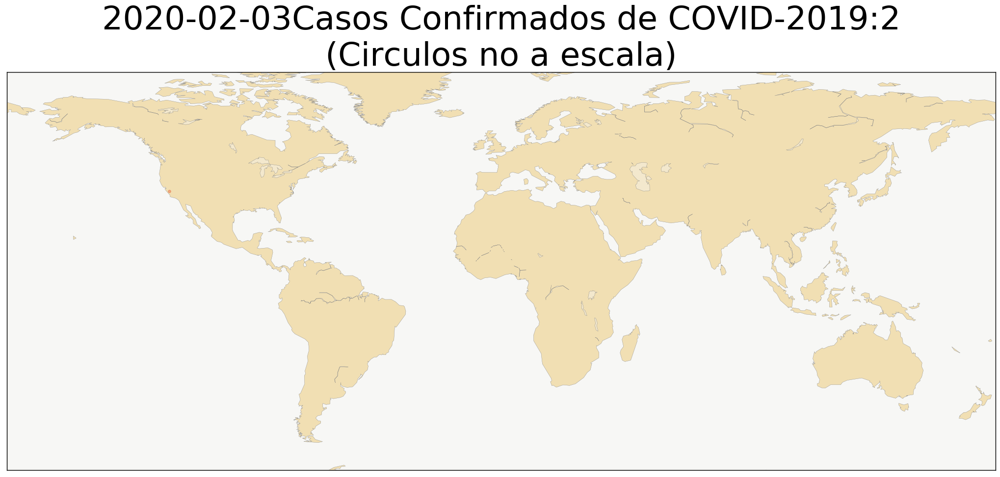

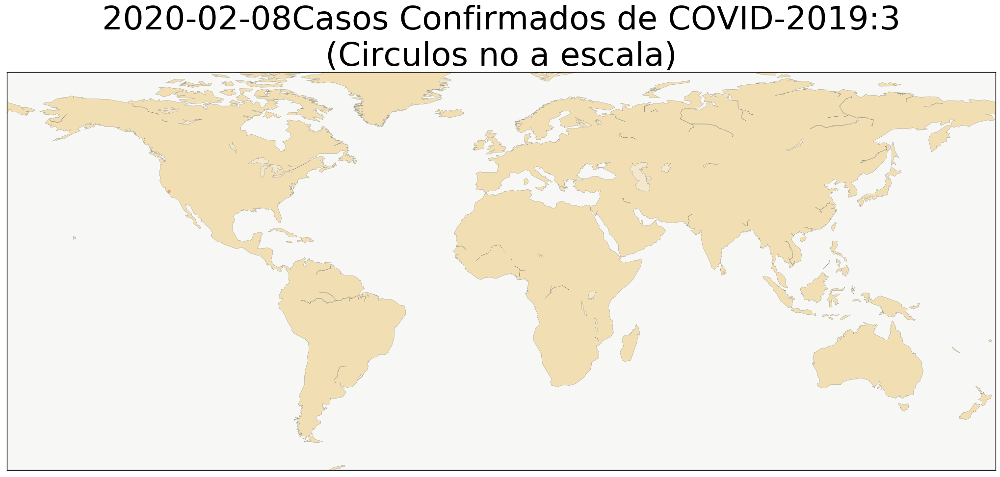

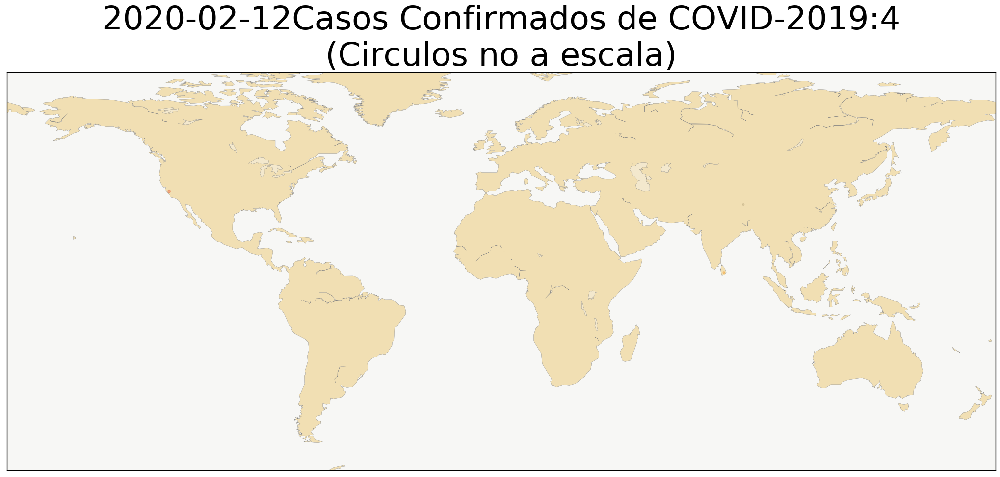

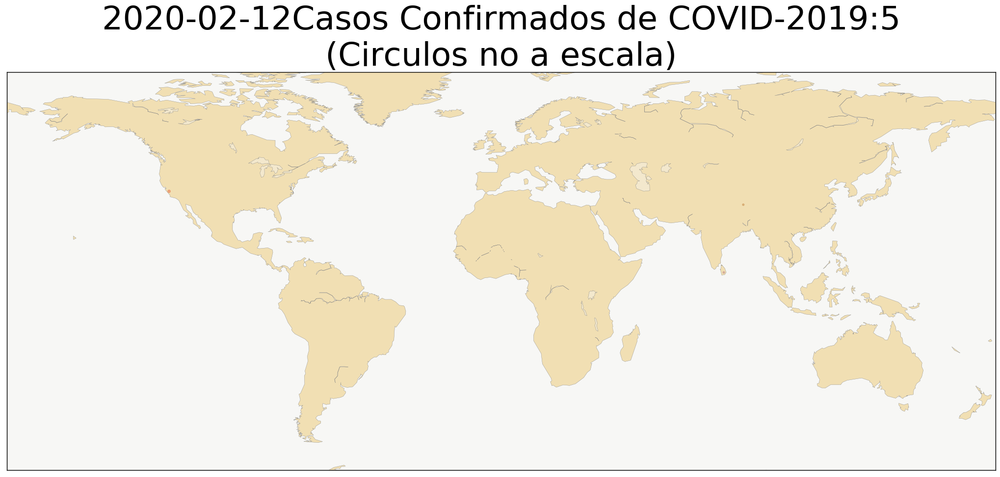

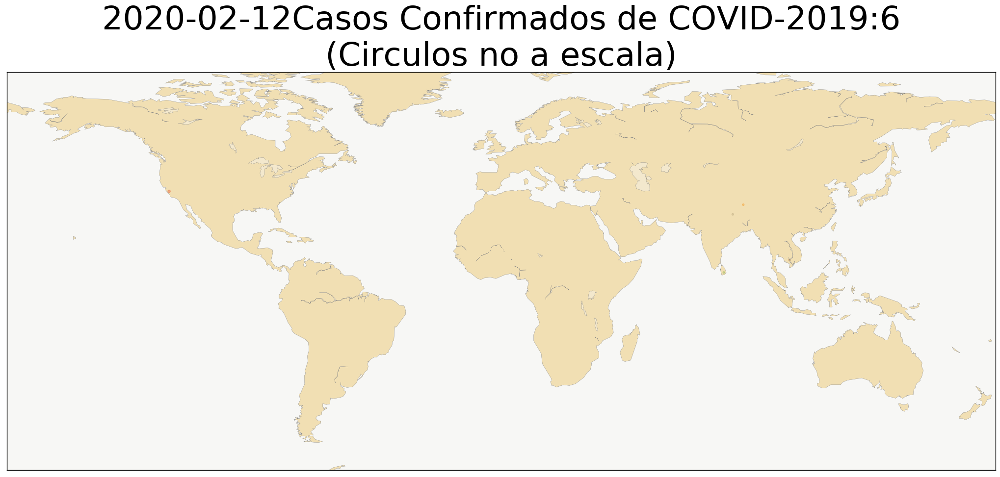

...

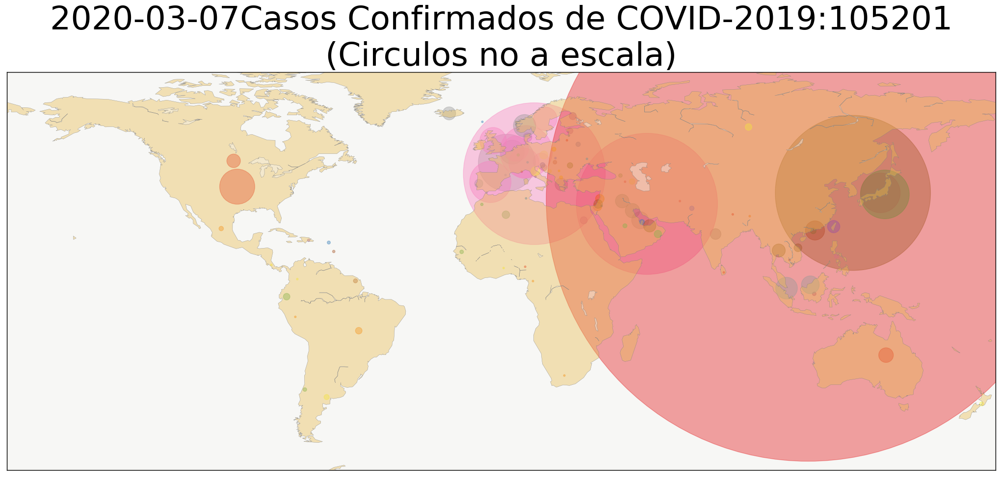

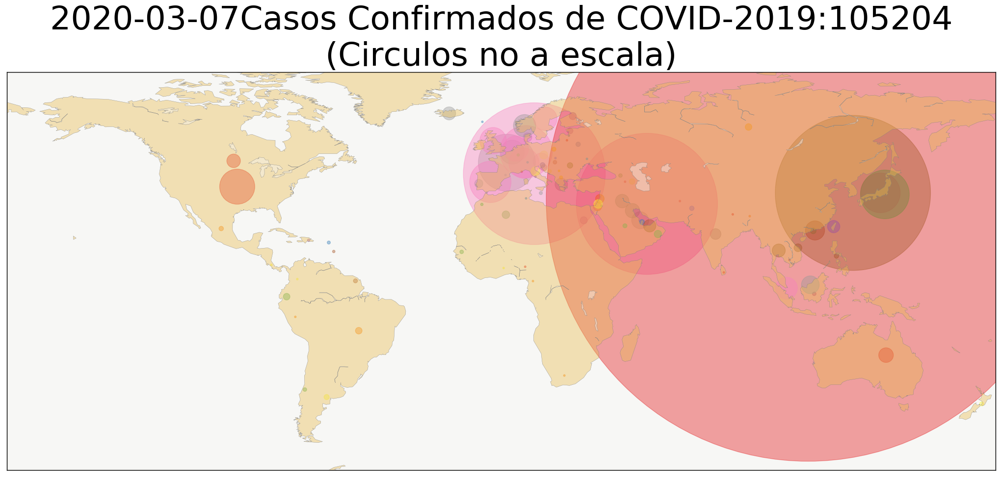

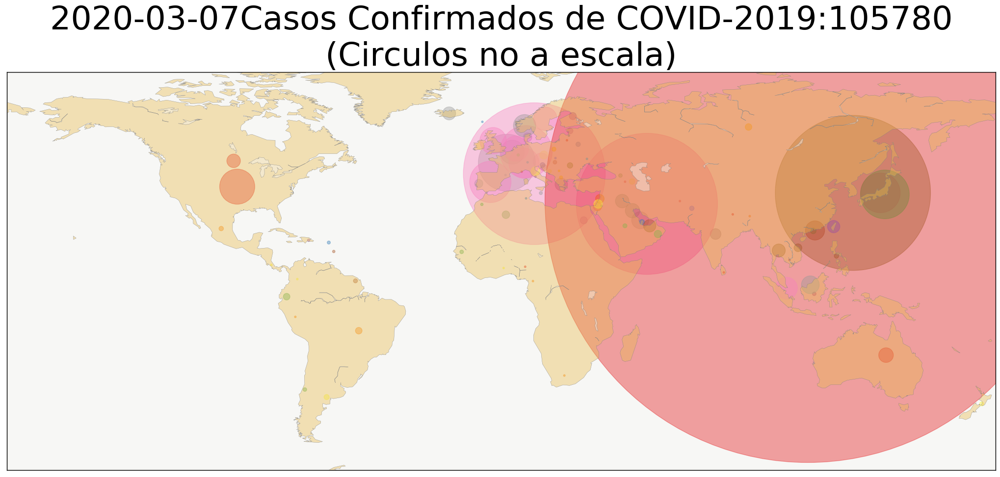

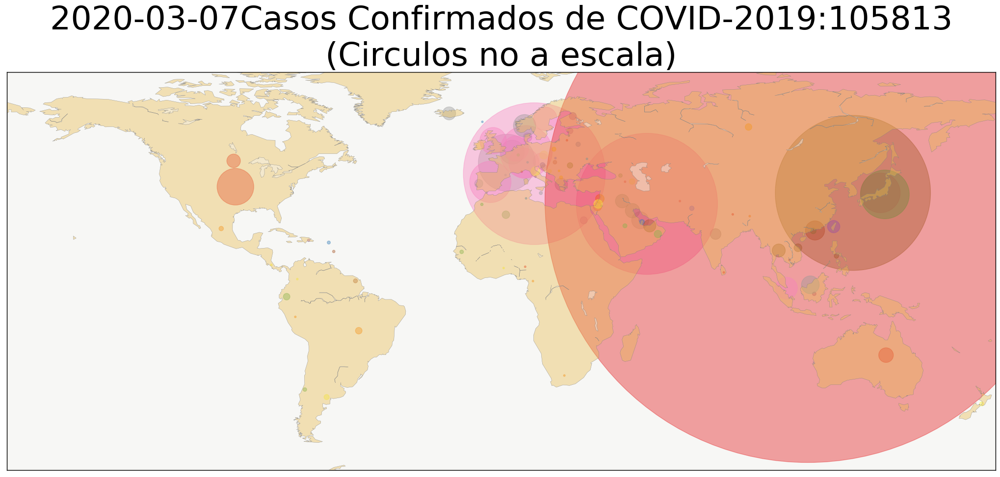

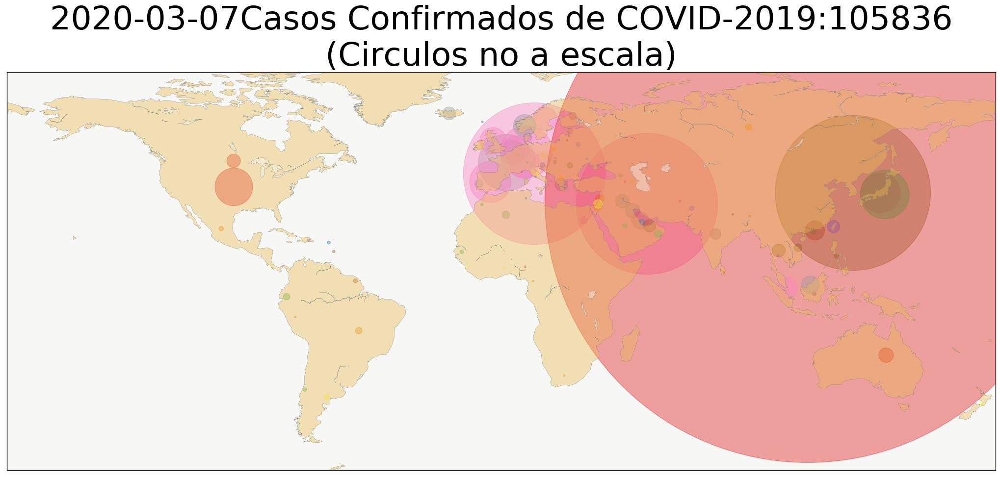

In [53]:
#Creamos lista de imágenes
image_file_name_counter = 0
for date in dates:
    virus_today = Covid2019_data[Covid2019_data['Last Update'] <= date]
    
    # simplifico data set
    virus_today = virus_today[['Country/Region','Province/State', 'labels_enc', 'Confirmed',
                         'Deaths', 'Recovered',
                         'Longitude', 'Latitude']]


    
    # agrupo por paises
    virus_today=virus_today.groupby(['Country/Region', 'Province/State', 'labels_enc']).agg({'Confirmed':'last', 
                               'Deaths':'last',
                               'Recovered':'last',
                               'Longitude':'mean',
                              'Latitude':'mean'}).reset_index()



    # agrupo
    virus_today=virus_today.groupby(['Country/Region', 'labels_enc']).agg({'Confirmed':'sum', 
                               'Deaths':'sum',
                               'Recovered':'sum',
                               'Longitude':'mean',
                              'Latitude':'mean'}).reset_index()
     
    # mapa de casos confirmados
    file_to_save_name = 'anim_' + str(image_file_name_counter) + '.png'
    plot_map_mundo(virus_today, str(date)[0:10], file_to_save_name)
    
  
    image_file_name_counter += 1